In [1]:
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

from scipy.io import wavfile

# Sound

Sounds are mechanical waves, oscillations that move in space.. They are a specific form of signals, and can be represented as a function $f: \mathbb{R} \rightarrow \mathbb{R}$ [1]. They originate from a vibrating object.

2. They need a medium to propagate and expand in. 
3. Sound waves are characterized by compression and rarefaction.

In [2]:
ipd.Audio("data/le_jardin.wav")

The audio sample is a fragment of *Le Jardin*, a song by French artist McBaise, played on a electric guitar. It is a music piece played in F# minor scale.

## Waveform

Waveforms provide us with information about the signal. In music, we can use it to infer on audio's *timbre* which encapsulates macroscopic characteristics such as the attack, vibrato, coloration, noise, echo, reverbation. If we try to analyze a sound using a sound envelope, we can observe its elemets including: **attack**, **decay**, **sustain**, **release** in its waveform.

Here, I will use Scipy's wavfile module to read the audio. This will return the signal's samples and the sample rate. From these, we can derive the duration. Finally I will plot the waveform using Matplotlib package. Let's see how the fragment's waveform looks like.

Signal length: 1242624 [data points]
Sampling rate: 44100 [Hz]


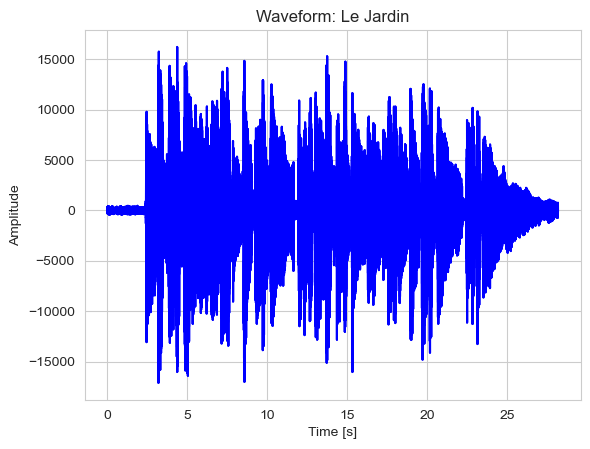

In [3]:
sampling_rate, signal = wavfile.read("data/le_jardin.wav")

print("Signal length: %d [data points]" % len(signal))
print("Sampling rate: %d [Hz]" % sampling_rate)

def plot_waveform(signal: np.array, sr: int, title: str):
    duration = len(signal) / sr
    total_time = np.arange(0, duration, 1/sr)

    sns.set_style(style="whitegrid")
    plt.plot(total_time, signal, color='b')
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.title(title)
    plt.show()

plot_waveform(signal=signal, sr=sampling_rate, title="Waveform: Le Jardin")

We can see that there is a part with lower amplitude at the beginning of the recording, which is just background noise. Then, we can see the representation of the guitar riff, characterized by higher amplitude of the oscillations, finally the closing part presenting the release of the sound.  

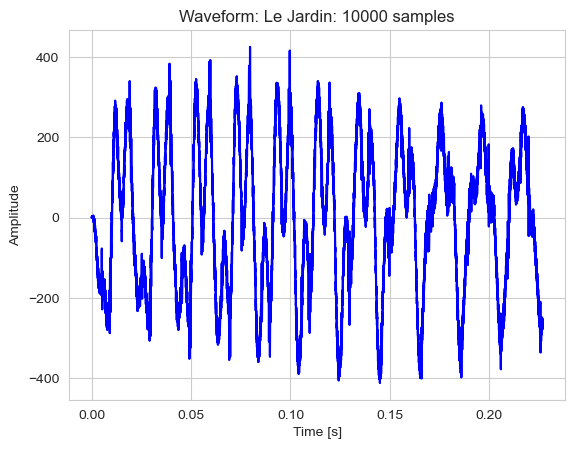

In [4]:
plot_waveform(signal=signal[:10000], sr=sampling_rate, title="Waveform: Le Jardin: 10000 samples")

In the above plot, we can see the signal's peaks and dips a little bit better. This is mostly the noise originating from the amplifier and guitar effects.

# Identify start of the riff

Let's say that the recording is a pilot that we want to show to the band. But first, we need to clean it up a bit, chunk it in such a way that the amplifier's and effect board's noise is cut from our recording and we will be left just with the signal starting with F# minor chord. We can either do it by ear, or we can use specific audio processing techniques: amplitude envelope and root-mean-square energy. 

## Naive Approach

We can use a naive approximation to extract the chunk in which the guitar starts playing the first tone. We guesstimate that this starts around 2 seconds since the start. Let's see if this is correct: 
1. Computing the duration of 1 sample in our signal.
2. Finding how many data points to skip (samples): this will be our start index.
3. Visualizing a small chunk of our audio to see if the amplitude peak (compression) aligns with our prediction.

 

In [5]:
# to get the duration of one sample, we can use the following computation
duration_of_sample = 1 / sampling_rate

print("Duration of a sample: %0.6f [s]" % duration_of_sample)

# the chord starts at 0:02, so we want to skip x number of samples until that moment.
# The first part contains the effect board/amplifier noise, so we want to skip it to proceed to the samples of first chord (F# minor).

start_time = 2 # in seconds
start_index = int(start_time / duration_of_sample)
start_index
print("The start index of F# sample: %d [samples]" % start_index)

Duration of a sample: 0.000023 [s]
The start index of F# sample: 88200 [samples]


Now, the question is how much we want to plot. Considering that we have 1,242,624 samples, and around 28 seconds of the recording, we can zoom-in into 2 seconds interval to inspect the sound wave. This means that we will start from the computed index and inspect a part with the same number of samples as we have skipped (88200).

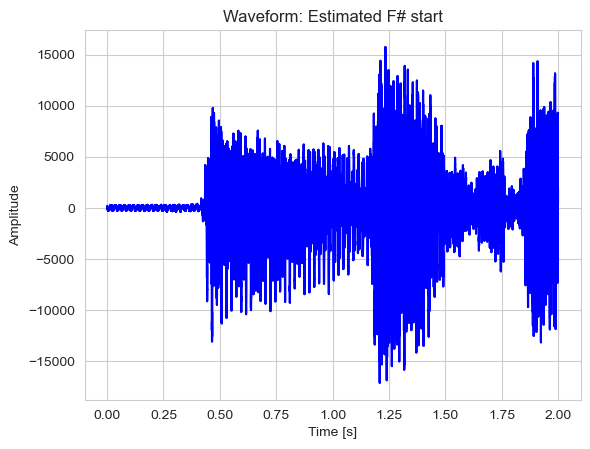

In [6]:
subsignal = signal[start_index:start_index + start_index]

plot_waveform(signal=subsignal, sr=sampling_rate, title="Waveform: Estimated F# start")

This seems correct, shifting the scale by 2 seconds, we observe in a more representative zooming that the attack in F# minor chord starts around 2:24. Let's see if this is correct chopping the noisy part and saving the signal to a new audio.

In [7]:
corrected_start_index = int(2.24 / duration_of_sample)
print("Start at sample: %d" % corrected_start_index)

Start at sample: 98784


Voilà! Let's save it to the disk and display the new audio using IPython.

In [8]:
wavfile.write("data/new_le_jardin_naive_approach.wav", rate=sampling_rate, data=signal[corrected_start_index:])
ipd.Audio("data/new_le_jardin_naive_approach.wav")

### Amplitude Envelope

To attempt to extract the start of the chord in a more precise way, we can refer to amplitude envelope technique. It goes through the frames of our signal and from each frame, takes the maximum value of the samples' amplitude. This technique is obviously susceptible to outliers, however, the first sample of F# chord will be the outlier among the distribution of amplitudes of amplifier noise. This is what we are looking for.

Considering that we are taking the maximum value of the amplitude of samples for each frame (t), we will use the following formula:

$$ AE_{t} = \max^{(t + 1) \cdot K - 1}_{k = t \cdot K}{s(k)}

Were $t$ corresponds to frame, $K$ is the frame size, $s(k)$ is the amplitude at sample $k$.

We will be using windowing for the extraction of the amplitude envelope. For this, we will use FRAME_SIZE and HOP_LENGTH constants.

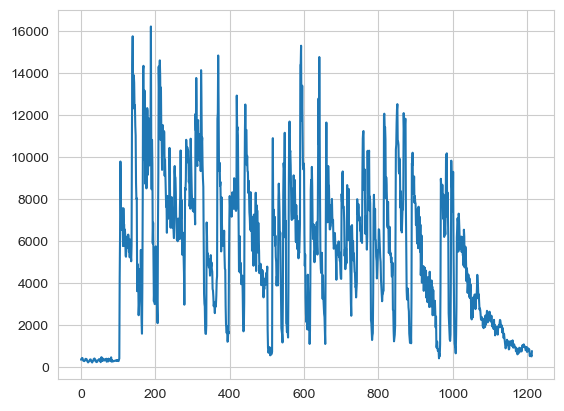

In [9]:
FRAME_SIZE = 1024
HOP_LENGTH = 1024

def get_amplitude_envelope(signal, frame_size, hop_length):
    return np.array([np.max(signal[i:i+frame_size]) for i in range(0, len(signal), hop_length)])

amplitude_envelope = get_amplitude_envelope(signal=signal, frame_size=FRAME_SIZE, hop_length=HOP_LENGTH)

plt.plot(range(0, len(amplitude_envelope)), amplitude_envelope)
plt.show()

As we can see, we have identified the first occurrence of significantly higher amplitude around the frame number 100. Since we are not using overlapping windows, it means that this is around sample number 102400. Let's get this value.

In [10]:
# we will be comparing an observation to the value which occurred 10 timestamps before.
WINDOW_SIZE = 10
# the threshold is set to detect anomaly which has an amplitude 10 times bigger than the value it is compared to
OUTLIER_MAGNITUDE = 10
anomaly_index = 0

def find_anomalous_frame(feature_set: np.array,
                         window_size: int = WINDOW_SIZE, 
                         outlier_magnitude: int = OUTLIER_MAGNITUDE) -> dict | None:
    """
    Function for identifying the frame index which contains an outlier.
    If no such outlier is found, None is returned.
    """
    for i in range(0, len(feature_set)):
        # let go of the first WINDOW_SIZE samples to adjust the comparison.
        if i < window_size:
            continue
        if feature_set[i] > feature_set[i - window_size] * outlier_magnitude:
            
            anomaly_index = i
            # we do not want to continue, we need just the first occurrence
            return {
                "anomaly_index": anomaly_index,
                "anomalous_value": feature_set[i]
            }

anomaly_info = find_anomalous_frame(feature_set=amplitude_envelope)
anomaly_index = anomaly_info["anomaly_index"]
anomaly_value = anomaly_info["anomalous_value"]
print("Anomaly found at frame: %d, with value: %0.2f" % (anomaly_index, anomaly_value))

Anomaly found at frame: 104, with value: 4197.00


As it is shown below, we factually discovered the first frame whith the anomalous amplitude. Now, we can extract the sample.

In [11]:
amplitude_envelope[anomaly_index - 10: anomaly_index + 1]

array([ 305,  294,  312,  291,  297,  327,  285,  275,  345,  401, 4197],
      dtype=int16)

In [12]:
beginning_of_anomalous_frame = FRAME_SIZE * (anomaly_index - 1)
beginning_of_anomalous_frame

105472

Plotting the first 100 samples of the anomalous frame, we should see the rise of amplitude to a certain degree.

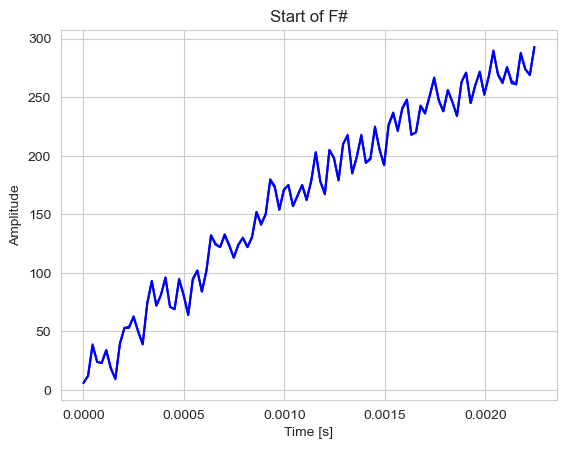

In [13]:
plot_waveform(signal[beginning_of_anomalous_frame:beginning_of_anomalous_frame+100], sr=sampling_rate, title="Start of F#")

Saving and displaying the new audio, we can compare it with the previous method.

In [14]:
# the output data is the sub-signal derived from the original one, indexed from the identified anomalous frame
output_data = signal[beginning_of_anomalous_frame:]
wavfile.write("data/new_le_jardin_ae_approach.wav", rate=sampling_rate, data=output_data)
ipd.Audio("data/new_le_jardin_ae_approach.wav")

### Root-mean-square energy

This is another low-level acoustic features extraction method. It is a proxy to evaluate approximate loudness of each frame. It is less-susceptible to outliers, let's compare this method to amplitude envelope. The following formula will be used for the algorithm:

$$RMSE_{t} = \sqrt{\frac{1}{K} \cdot \sum^{(t + 1) \cdot K - 1}_{k = t \cdot K} s(k)^{2}}

Where $t$ corresponds to the frame, $K$ is the frame size and $s(k)$ is the amplitude.

In [15]:
def get_rms_energy(signal, frame_size, hop_length) -> np.array:
    rms = [] 
    for i in range(0, len(signal), hop_length):
        rms_current_frame = np.sqrt(
            # taking the absolute value before taking the square root 
            # to avoid warnings (originating from taking square root of negative values)
            np.abs(
                np.sum(signal[i:i+frame_size] ** 2) / frame_size
                )
            )
        rms.append(rms_current_frame)
    return np.array(rms)

rms_energy = get_rms_energy(signal=signal, frame_size=FRAME_SIZE, hop_length=HOP_LENGTH)

### Finding the frame with anomaly

Now, knowing that the closest value we found with amplitude envelope is 104, and it is, percetually, correct index, we can attempt to optimize the values for RMSE search. We will use the absolute error from anomaly_index value to find the optimal combination of values for the threshold of deviation between RMS energy samples and the search scope (window size).

In [16]:
magnitude_values = np.linspace(2, 10, 100)
window_sizes = np.arange(10, 150, 5)


# we know that index 104 was the closest to beginning of the chord
correct = 104
# we initialize the error and best combination to None
# They will be replaced upon iteration's computation
error = None
best = None

for mv in magnitude_values:
    for window_size in window_sizes:
        idx_value = find_anomalous_frame(feature_set=rms_energy, window_size=window_size, outlier_magnitude=mv)["anomaly_index"]
        # we immediately find the correct index.
        if idx_value == correct:
            print("Magnitude: %f | Window size: %d" % (mv, window_size))
            break
        # we cannot find the index yet, so we get some error (distance to correct index)
        # we try to minimize it, so we memorize the error and compare the error of the
        # next iteration. 
        # if it is smaller in the next iteration, we replace the previous
        # best combination, with the new combination which reduced the error.
        else:
            if error is None:
                error = np.abs(correct - idx_value)
            elif error > np.abs(correct - idx_value):
                error = np.abs(correct - idx_value)
                best = mv, window_size
            else:
                continue 
print("Optimal magnitude: %0.3f, optimal window size: %d" % (best[0], best[1]))



Optimal magnitude: 2.000, optimal window size: 80


In [17]:
rmse_anomaly = find_anomalous_frame(feature_set=rms_energy, window_size=best[1], outlier_magnitude=best[0])
rmse_anomaly

{'anomaly_index': 103, 'anomalous_value': 112.40828726955588}

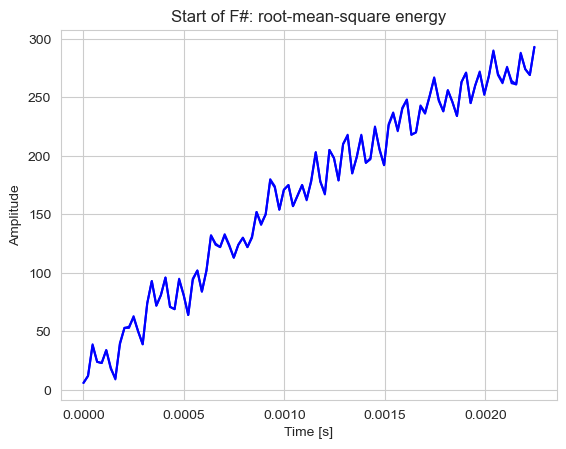

In [18]:
rmse_detected_anomaly_index = rmse_anomaly["anomaly_index"] * FRAME_SIZE

plot_waveform(signal[rmse_detected_anomaly_index: rmse_detected_anomaly_index + 100], sr=sampling_rate, title="Start of F#: root-mean-square energy")

In [19]:
# the output data is the sub-signal derived from the original one, indexed from the identified anomalous frame
output_data = signal[rmse_detected_anomaly_index:]
wavfile.write("data/new_le_jardin_rmse_approach.wav", rate=sampling_rate, data=output_data)
ipd.Audio("data/new_le_jardin_rmse_approach.wav")

## Conclusions

In this simplistic case, any of the methods worked properly. Although, since many times we deal with noisy, complex signals, one method might be preferred over another. We can assume that amplitude envelope is better when we need to explicily find the outlier, just as in this example. The plot of AE values was easy to interpret and the extraction of anomalous frame was straighforward. On the other hand, if we need to compare noisy samples with big anomalous obervations for noise, RMS energy might be a better low-level acoustic feature alternative.

## References

\[1\] Meinard Müller and Sebastian Rosenzweig. PCP Notebooks: A Preparation Course for Python with a Focus on Signal Processing. Journal of Open Source Education (JOSE), 5(47), 2022.